In [1]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.keras.applications.efficientnet import preprocess_input
import pathlib
from tensorflow.keras import models
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras import regularizers
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

2025-08-17 17:01:35.001298: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1755450095.222484      36 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1755450095.285485      36 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
train_dir = "/kaggle/input/plantvillage/PlantVillage/train"
val_dir   = "/kaggle/input/plantvillage/PlantVillage/val"


In [3]:
BATCH_SIZE = 32
IMG_SIZE = (128, 128)

In [4]:
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    seed=123,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE
)

Found 43444 files belonging to 38 classes.


I0000 00:00:1755450164.778013      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


In [5]:
val_dataset = tf.keras.preprocessing.image_dataset_from_directory(
   val_dir,
    seed=123,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE)

Found 10861 files belonging to 38 classes.


In [6]:
val_size = tf.data.experimental.cardinality(val_dataset).numpy()
test_dataset = val_dataset.take(val_size // 3)
val_dataset = val_dataset.skip(val_size // 3)


In [7]:
class_names = train_dataset.class_names
num_classes = len(class_names)
print("Classes:", class_names)
print(len(class_names))

Classes: ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___

In [8]:
test_dataset

<_TakeDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [9]:
def display_images_per_class(folder_path, num_images=5, show_paths=False):
    paths_per_class = {}
    class_names = [cls for cls in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, cls))]
    for class_name in class_names:
        class_path = os.path.join(folder_path, class_name)
        all_images = [os.path.join(class_path, img) for img in os.listdir(class_path)]
        paths_per_class[class_name] = all_images[:num_images]
    for cls, paths in paths_per_class.items():
        fig, axes = plt.subplots(1, len(paths), figsize=(15, 3))
        if len(paths) == 1:
            axes = [axes]
        for ax, img_path in zip(axes, paths):
            img = mpimg.imread(img_path)
            ax.imshow(img)
            ax.axis('off')
            if show_paths:
                ax.set_title(os.path.basename(img_path), fontsize=8)
        plt.suptitle(cls, fontsize=10)
        plt.show()


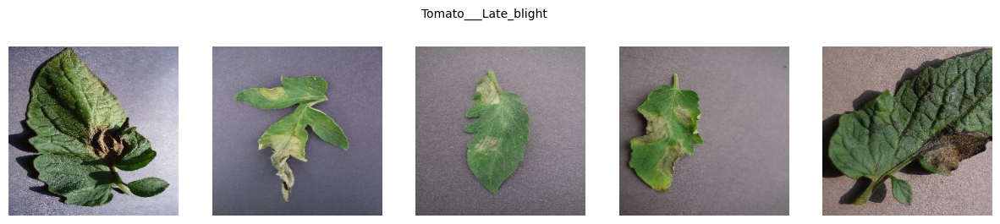

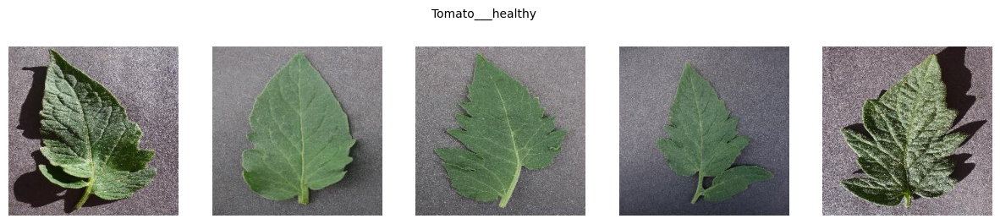

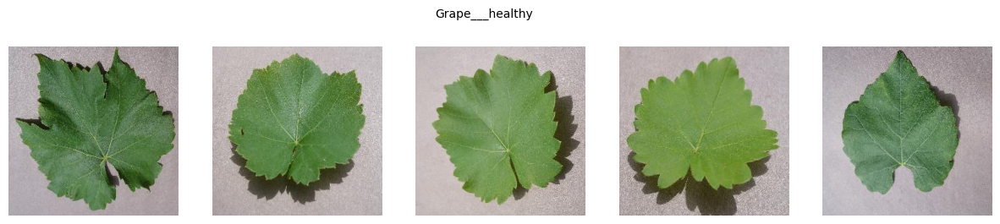

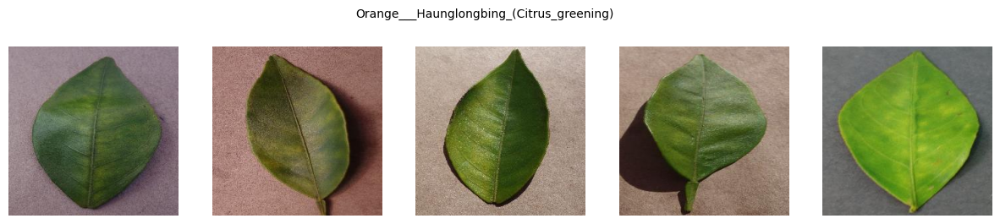

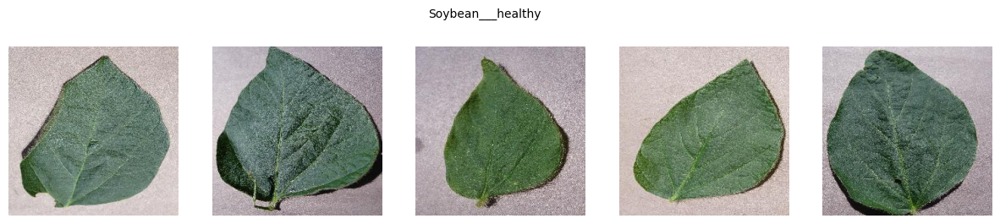

...

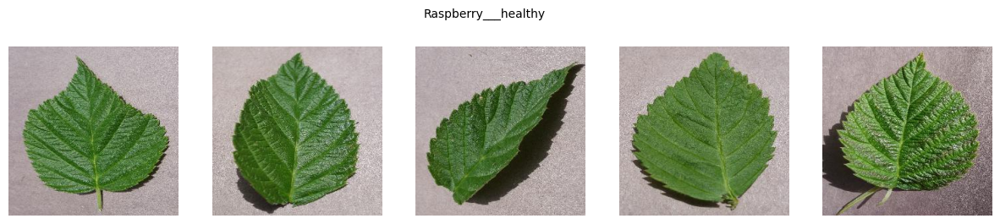

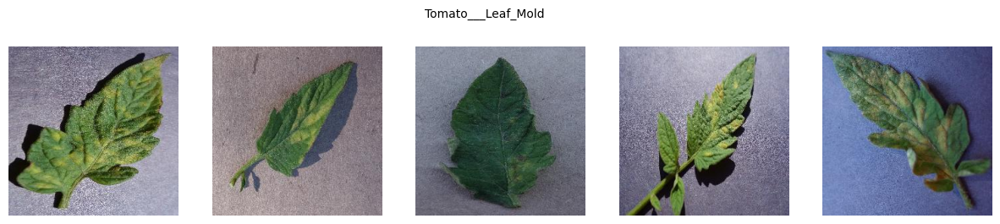

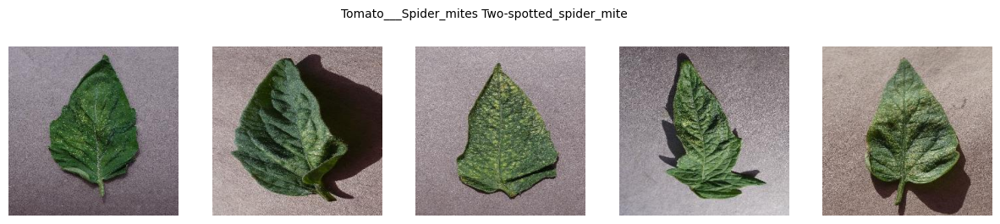

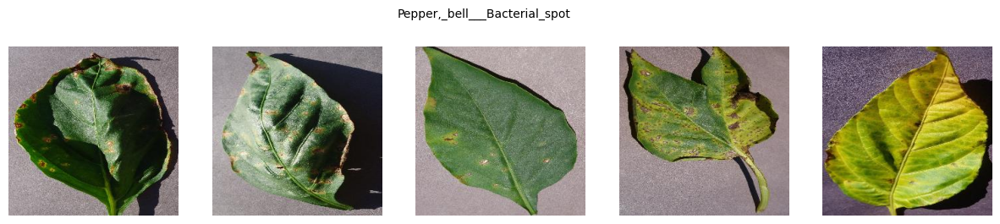

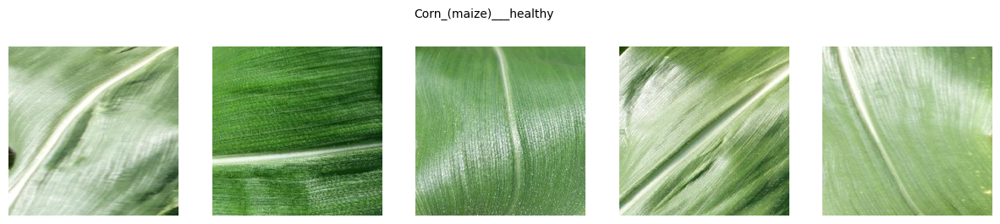

In [10]:
train_dir = "/kaggle/input/plantvillage/PlantVillage/train"
display_images_per_class(train_dir, num_images=5, show_paths=False)

In [11]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    layers.RandomContrast(0.1),
    layers.RandomBrightness(0.1)
])

In [12]:
def preprocess(x, y):
    x = preprocess_input(x)   
    y = tf.one_hot(y, depth=num_classes)
    return x, y


In [13]:
train_dataset = train_dataset.map(
    lambda x, y: preprocess(data_augmentation(x, training=True), y),
    num_parallel_calls=tf.data.AUTOTUNE
)
val_dataset = val_dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE)
test_dataset = test_dataset.map(preprocess, num_parallel_calls=tf.data.AUTOTUNE)

In [14]:
train_dataset = train_dataset.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_dataset   = val_dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE)
test_dataset  = test_dataset.cache().prefetch(buffer_size=tf.data.AUTOTUNE)


In [15]:
train_dir = pathlib.Path(train_dir)
train_counts = {class_name: len(list((train_dir / class_name).glob('*')))
                for class_name in class_names}
print("Train counts:", train_counts)

Train counts: {'Apple___Apple_scab': 504, 'Apple___Black_rot': 496, 'Apple___Cedar_apple_rust': 220, 'Apple___healthy': 1316, 'Blueberry___healthy': 1202, 'Cherry_(including_sour)___Powdery_mildew': 842, 'Cherry_(including_sour)___healthy': 684, 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 410, 'Corn_(maize)___Common_rust_': 953, 'Corn_(maize)___Northern_Leaf_Blight': 788, 'Corn_(maize)___healthy': 929, 'Grape___Black_rot': 944, 'Grape___Esca_(Black_Measles)': 1107, 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 861, 'Grape___healthy': 339, 'Orange___Haunglongbing_(Citrus_greening)': 4405, 'Peach___Bacterial_spot': 1838, 'Peach___healthy': 288, 'Pepper,_bell___Bacterial_spot': 797, 'Pepper,_bell___healthy': 1183, 'Potato___Early_blight': 800, 'Potato___Late_blight': 800, 'Potato___healthy': 121, 'Raspberry___healthy': 297, 'Soybean___healthy': 4072, 'Squash___Powdery_mildew': 1468, 'Strawberry___Leaf_scorch': 887, 'Strawberry___healthy': 364, 'Tomato___Bacterial_spot': 1702, 'T

In [26]:
base_model = tf.keras.applications.DenseNet121(
    include_top=False,   
    weights="imagenet",   
    input_shape=(128, 128, 3))
base_model.trainable = False
inputs = layers.Input(shape=(128,128,3))
x = tf.keras.applications.densenet.preprocess_input(inputs)  
  
x = base_model(x, training=False)   
x = layers.GlobalAveragePooling2D()(x)  

x = layers.Dropout(0.4)(x)  
x = layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.001))(x) 
outputs = layers.Dense(num_classes, activation="softmax")(x)  # output layer

model = models.Model(inputs, outputs)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5,
    patience=3,
    verbose=1)
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=7,
    restore_best_weights=True,
    verbose=1)

model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ true_divide_6 (TrueDivide)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ add_3 (Add)                     │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ true_divide_7 (TrueDivide)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ densenet121 (Functional)        │ (None, 4, 4, 1024)     │     7,037,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_3      │ (None, 1024)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       262,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 38)             │         9,766 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,309,670 (27.88 MB)

 Trainable params: 272,166 (1.04 MB)

 Non-trainable params: 7,037,504 (26.85 MB)

In [27]:
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=20,callbacks=[lr_scheduler, early_stopping]
)


Epoch 1/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 86s 44ms/step - accuracy: 0.6318 - loss: 1.5783 - val_accuracy: 0.8791 - val_loss: 0.5811 - learning_rate: 0.0010
Epoch 2/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 34s 25ms/step - accuracy: 0.8156 - loss: 0.7631 - val_accuracy: 0.8870 - val_loss: 0.5336 - learning_rate: 0.0010
Epoch 3/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 35s 25ms/step - accuracy: 0.8334 - loss: 0.6989 - val_accuracy: 0.8812 - val_loss: 0.5423 - learning_rate: 0.0010
Epoch 4/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 35s 26ms/step - accuracy: 0.8364 - loss: 0.6782 - val_accuracy: 0.8943 - val_loss: 0.4896 - learning_rate: 0.0010
Epoch 5/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 35s 26ms/step - accuracy: 0.8414 - loss: 0.6680 - val_accuracy: 0.8832 - val_loss: 0.5256 - learning_rate: 0.0010
Epoch 6/20
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 34s 25ms/step - accuracy: 0.8409 - loss: 0.6647 - val_accuracy: 0.8918 - val_loss: 0.4928 - learning_rate: 0.0010
Epoch 7/20
1357/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accurac

In [19]:
model.save("model_feature_extraction_dense.keras")

In [31]:
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
base_model.trainable = True
for layer in base_model.layers[:-50]:
    layer.trainable = False

model.compile(
    optimizer=Adam(learning_rate=1e-5),  
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

history_fine = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=40,
    callbacks=[lr_scheduler, early_stopping])

model.save("model_finetuned_densef.keras")


Epoch 1/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 107s 50ms/step - accuracy: 0.8030 - loss: 0.7639 - val_accuracy: 0.9288 - val_loss: 0.3349 - learning_rate: 1.0000e-05
Epoch 2/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 40s 29ms/step - accuracy: 0.8829 - loss: 0.4668 - val_accuracy: 0.9344 - val_loss: 0.3128 - learning_rate: 1.0000e-05
Epoch 3/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.8986 - loss: 0.4194 - val_accuracy: 0.9408 - val_loss: 0.2959 - learning_rate: 1.0000e-05
Epoch 4/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.9129 - loss: 0.3763 - val_accuracy: 0.9444 - val_loss: 0.2827 - learning_rate: 1.0000e-05
Epoch 5/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.9191 - loss: 0.3479 - val_accuracy: 0.9466 - val_loss: 0.2721 - learning_rate: 1.0000e-05
Epoch 6/40
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 41s 30ms/step - accuracy: 0.9275 - loss: 0.3265 - val_accuracy: 0.9495 - val_loss: 0.2612 - learning_rate: 1.0000e-05
Epoch 7/40
1358/1358 ━━━━━━━━━━━━━━━━━━

In [40]:
history_fine2 = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=70,             
    initial_epoch=40,      
    callbacks=[lr_scheduler, early_stopping])

Epoch 41/70
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - accuracy: 0.9976 - loss: 0.0781 - val_accuracy: 0.9776 - val_loss: 0.1394 - learning_rate: 5.0000e-06
Epoch 42/70
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - accuracy: 0.9977 - loss: 0.0775 - val_accuracy: 0.9753 - val_loss: 0.1416 - learning_rate: 5.0000e-06
Epoch 43/70
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - accuracy: 0.9983 - loss: 0.0758 - val_accuracy: 0.9763 - val_loss: 0.1424 - learning_rate: 5.0000e-06
Epoch 44/70
1357/1358 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.9977 - loss: 0.0757
Epoch 44: ReduceLROnPlateau reducing learning rate to 2.499999936844688e-06.
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - accuracy: 0.9977 - loss: 0.0757 - val_accuracy: 0.9754 - val_loss: 0.1415 - learning_rate: 5.0000e-06
Epoch 45/70
1358/1358 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - accuracy: 0.9981 - loss: 0.0753 - val_accuracy: 0.9763 - val_loss: 0.1392 - learning_rate: 2.5000e-06
Epoch 46/70
1358/1358 ━━━━━━━━━━━━━━━━━━

In [41]:
def merge_histories(*histories):
    merged = {"loss": [], "val_loss": [], "accuracy": [], "val_accuracy": []}
    for h in histories:
        for k in merged.keys():
            merged[k].extend(h.history.get(k, []))
    return merged

def plot_history(merged_history):
    epochs = range(1, len(merged_history["loss"]) + 1)

    # Loss
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, merged_history["loss"], label="Training Loss")
    plt.plot(epochs, merged_history["val_loss"], label="Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.title("Training & Validation Loss")

    # Accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, merged_history["accuracy"], label="Training Accuracy")
    plt.plot(epochs, merged_history["val_accuracy"], label="Validation Accuracy")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.title("Training & Validation Accuracy")

    plt.show()

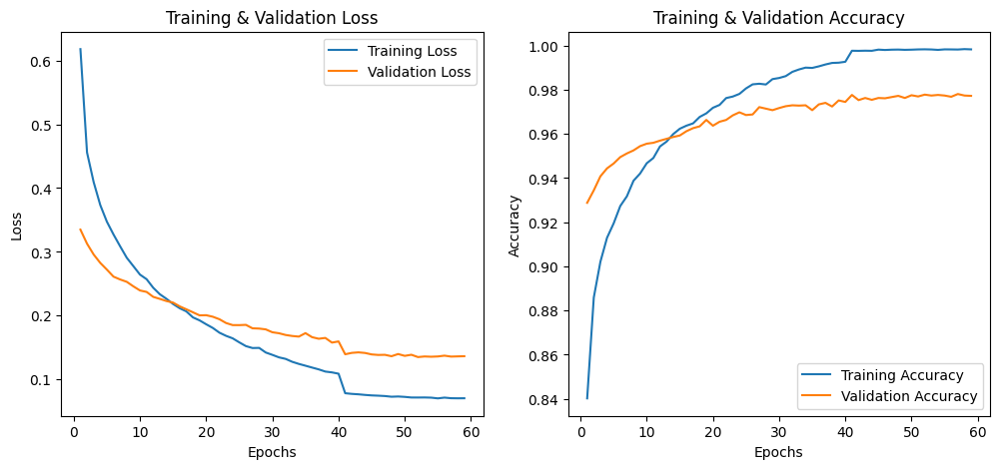

In [42]:
merged_history=merge_histories(history_fine,history_fine2)
plot_history(merged_history)

In [43]:
test_loss, test_accuracy = model.evaluate(test_dataset)
print(f"test_accuracy: {test_accuracy:.4f}")
print(f"test_loss: {test_loss:.4f}")

113/113 ━━━━━━━━━━━━━━━━━━━━ 4s 36ms/step - accuracy: 0.9710 - loss: 0.1585
test_accuracy: 0.9729
test_loss: 0.1552


In [45]:
def predict(model, test_dataset):
    all_images, all_true, all_pred = [], [], []

    for images, labels in test_dataset:
        preds = model.predict(images)
        pred_classes = np.argmax(preds, axis=1)
        true_classes = np.argmax(labels.numpy(), axis=1)

        for img, true_idx, pred_idx in zip(images, true_classes, pred_classes):
            all_images.append(img)
            all_true.append(true_idx)
            all_pred.append(pred_idx)

    return all_images, all_true, all_pred

    


In [46]:
images, true_labels, pred_labels=predict(model,test_dataset)

1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━

In [47]:
def show_image(img_tensor, true_label, pred_label, class_names):
    if len(img_tensor.shape) == 4:
        img_tensor = img_tensor[0]
    img = img_tensor.numpy()
    if img.max() > 1.0:
        img = img / 255.0
    if img.min() < 0:
        img = (img + 1) / 2.0
    if len(img.shape) == 2:  
        img = np.stack([img]*3, axis=-1)
    elif img.shape[-1] == 1:
        img = np.concatenate([img]*3, axis=-1)
    img = np.clip(img, 0, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"True: {class_names[true_label]}\nPred: {class_names[pred_label]}")
    plt.show()



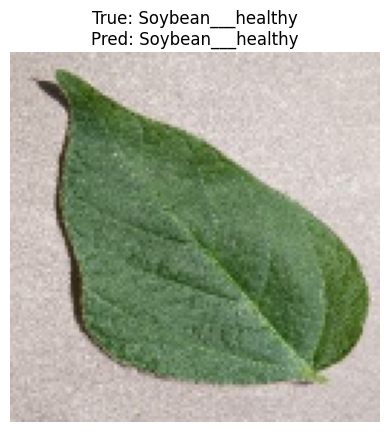

In [48]:
show_image(images[0], true_labels[0], pred_labels[0], class_names)

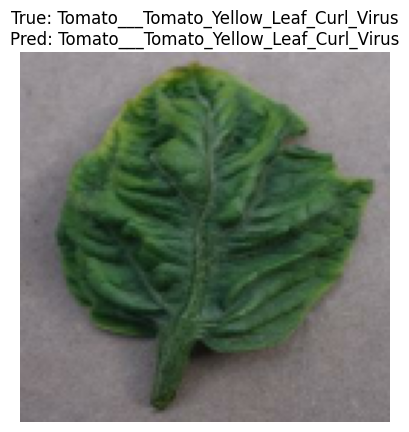

In [49]:
show_image(images[100], true_labels[100], pred_labels[100], class_names)

In [50]:
len(images)

3616

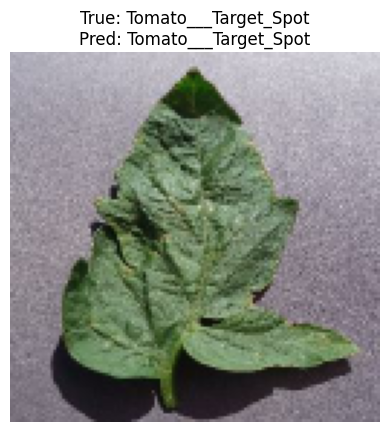

In [51]:
show_image(images[1200], true_labels[1200], pred_labels[1200], class_names)

In [52]:
 print(classification_report(true_labels, pred_labels, target_names=class_names))

                                                    precision    recall  f1-score   support

                                Apple___Apple_scab       0.95      0.97      0.96        40
                                 Apple___Black_rot       1.00      0.98      0.99        44
                          Apple___Cedar_apple_rust       0.94      1.00      0.97        16
                                   Apple___healthy       0.95      0.97      0.96       115
                               Blueberry___healthy       1.00      1.00      1.00        99
          Cherry_(including_sour)___Powdery_mildew       1.00      0.96      0.98        71
                 Cherry_(including_sour)___healthy       0.97      1.00      0.98        59
Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot       0.83      0.76      0.79        33
                       Corn_(maize)___Common_rust_       1.00      0.99      0.99        86
               Corn_(maize)___Northern_Leaf_Blight       0.85      0.91      0.

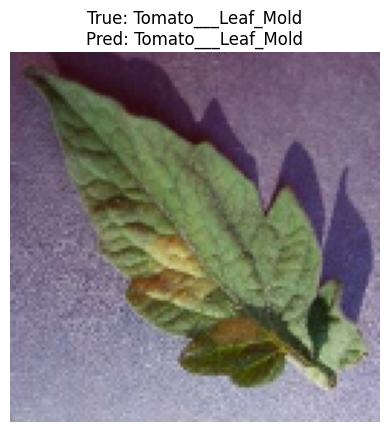

In [53]:
show_image(images[303], true_labels[303], pred_labels[303], class_names)

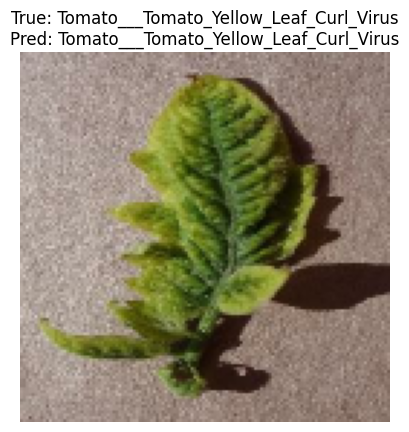

In [55]:
show_image(images[312], true_labels[312], pred_labels[312], class_names)

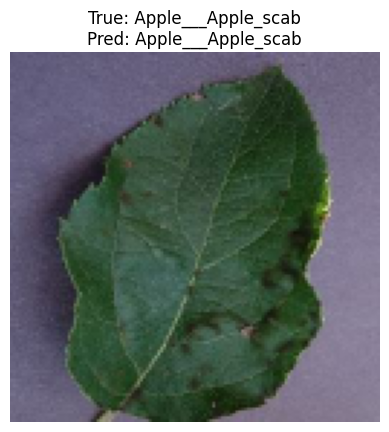

In [56]:
show_image(images[550], true_labels[550], pred_labels[550], class_names)

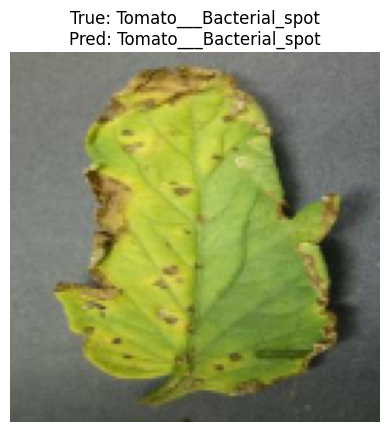

In [57]:
show_image(images[2200], true_labels[2200], pred_labels[2200], class_names)